
<img src="https://drive.google.com/uc?id=1tCXsv0yanvQqncB9ke8x6fCKonu4z4iB" alt="TorchDEQ Logo" width="60" align="left">

# A Quick Tour into Deep Equilibrium Models

In this notebook, we will have a quick tour into Deep Equilibrium (DEQ) Models using TorchDEQ.

This tour starts with an introduction to DEQ models, the forward and backward passes, and how to implement them using TorchDEQ's easy-to-use APIs.

Then, it follows by a toy 1D case to verify the correctness of solvers and gradients. We will visualize how the numerical solver converges to the fixed point.

Finally, this tutorial will implement and train a real-world DEQ model on cloud GPU. Benefiting from DEQ's parameter efficiency, we can compress images into neural nets using a DEQ version of implicit neural representation (DEQ-INR). As we build implicit representations through implicit layers, this model is also termed as $(\text{Implicit})^2$. We optimize the training speed of DEQ-INR via a series of techniques.

This notebook includes the following contents:

1. DEQ as an operator
  - Interface: the DEQ class
  - Numerical solvers: Fixed Point Iteration
  - Implicit Differentiation and Inexact Gradients
2. A toy case
  - Solving 1D fixed point systems.
  - Differentiating through fixed points.
3. A real-world DEQ models
  - Representing images into neural nets
  - DEQ-SIREN and DEQ-MFN
  - Training Efficiency
  - Analysis


Hopefully, this notebook offers a sense of how we can build a DEQ model using TorchDEQ.


By Zhengyang Geng, Eungyeup Kim, and J. Zico Kolter.

In [1]:
!pip install torchdeq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.0/45.0 kB 1.6 MB/s eta 0:00:00


## Deep Equilibrium Models

![implicit_layer](https://drive.google.com/uc?id=1OxLgYyuH492lAcix1H1qvgjFUWLNzg--)

Deep Equilibrium Models, or DEQ, is a new type of implicit neural networks that maps the input injection to the fixed point of neural dynamical system. For example, given an input image $\mathbf{x}$, the network will produce the prediction based on the solved fixed point $\mathbf{z}^*$, i.e.,

\begin{equation}
  \mathbf{z}^\star = f_\theta (\mathbf{z}^\star, \mathbf{x}).
\end{equation}

To differentiate this system, we can calculate the implicit gradient through the fixed point based on the Implicit Function Theorem (IFT),

\begin{equation}
  \frac{d L}{d θ} = \frac{d L}{d \mathbf{z}^\star} \frac{d \mathbf{z}^\star}{d θ} = \frac{d L}{d \mathbf{z}^\star} (I - \frac{∂ f}{∂ \mathbf{z}^\star})^{-1} \frac{∂ f}{∂ θ}.
\end{equation}

Or we can differentiate through the equilibrium system using inexact gradient like the phantom gradient,

\begin{equation}
  \frac{d L}{d θ} = \frac{d L}{d \mathbf{z}^\star} (I - \frac{∂ f}{∂ \mathbf{z}^\star})^{-1} \frac{∂ f}{∂ θ} ≈ \frac{d L}{d \mathbf{z}^\star} A.
\end{equation}

That is to say, we need to solve the fixed point in the forward pass and then differentiate through fixed point by solving another (linear) fixed point equation in the backward pass (or partially solving it, leading to the inexact gradient). This *mirror* behavior in the forward and backward passes inspires how we should implement DEQ.

### Backward fixed-point equation

Particularly, for implicit differentiation, we only need to calculate the `vjp` of $\frac{d L}{d \mathbf{z}^*} (I - \frac{∂ f}{∂ \mathbf{z}^*})^{-1}$ (where `v` is $\frac{d L}{d \mathbf{z}^*}$, and the Jacobian `j` is $(I - \frac{∂ f}{∂ \mathbf{z}^*})^{-1}$ defined by another fixed problem in the backward. Namely, we can compute $\mathbf{g}^* = \frac{d L}{d \mathbf{z}^*} (I - \frac{∂ f}{∂ \mathbf{z}^*})^{-1}$ via a *linear* fixed point system,

\begin{equation}
\mathbf{g}^* = \mathbf{g}^* \frac{∂ f}{∂ \mathbf{z}^*} + \frac{d L}{d \mathbf{z}^*}.
\end{equation}

After reaching $\mathbf{g}^*$, the auto differentiation engine will handle the next `vjp` of $\mathbf{g}^*$ and $\frac{∂ f}{∂ θ}$.

To calculate $\mathbf{g}^*$, we need to compute the `vjp` of $\mathbf{g}_k$ and $\frac{∂ f}{∂ \mathbf{z}^*}$ for multiple times in the backward solver until $\mathbf{g}_k$ converges to $\mathbf{g}^*$.



## The software design for DEQ

Based on the DEQ knowledge above, how can we support equilibrium models in a **modular** fashion using PyTorch? 🤔

First, let's imagine which type of API we want to build finally. Ideally, a function call to DEQ, given the equilibrium function $f_\theta$, should be an operator just like `torch.softmax`, enabling complex forward and backward passes in **a single line** of code.

Considering the variation and complexity of DEQ, merging DEQ models into a modern deep learning pipeline in a modular fashion might require stateful functionality. The statefulness needs to keep the parameters locally, which suggests implementing DEQ as a Pytorch Module.

The resulting interface in TorchDEQ is a single line of code. You can fetch a DEQ layer using this `get_deq` API. Then, this layer can be applied to different equilibrium functions for training or inference purposes.

Next, we come down to the use cases in different settings. Hopefully, we can give an impression of DEQ models and utilities of this library via the following cases.

In [2]:
import torch
from torchdeq import get_deq

import numpy as np
import matplotlib.pyplot as plt

## A toy case: DEQ in the 1D space

Let's start with several 1-dimensional fixed point systems!

- $z = f(z) = \cos(z)$
- $z = g(z) = 0.5 * (z + \frac{2}{z})$
- $z = h(z) = e^{-z}$

We employ the Broyden method (Quasi-Newton method for finding the roots) as the fixed point solver. Defining this "DEQ" layer requires only one line of code and can be used to solve different fixed point systems.

```
deq = get_deq(f_solver='broyden', f_max_iter=20, f_tol=1e-6)
```

`f_max_iter` and `f_tol` correspond to the max number of function evaluations (NFE) in the solver and the threshold for evaluating convergence, respectively. These two arguments can also be omitted to use the default values. Besides, the stop criteria, like absolute fixed point errors for monitoring $\|z - f(z)\|$ or relative fixed point errors for  $\|z - f(z)\| / \| f(z) \|$ can be passed to the `deq` layer through `f_stop_mode='abs'` or `f_stop_mode='rel'`. Once the fixed point errors reach the given threshold `f_tol`, the solver will break and return the fixed point estimation. The keyword arguments start with `'f_'`, because they customize the forward passes, while keyword arguments start with `'b_'` control the backward passes, i.e., gradient calculations.

After defining this `deq` layer, you can apply it to different fixed point systems, e.g., the 1D equilibrium functions above or high-dimensional ones. What you need is to define a function/functor that accepts the equilibrium variable(s) and pass it to the `deq` layer along with the initialization variable(s) as follows,

```
z_out, info = deq(f, z0)
```

where `f` is the equilibrium function, and `z0` is the initialization variable(s) for the fixed point solver. The `deq` layer will return the solved fixed point in `z_out` and include the solver statistics in `info`.

The `z_out` is a `list` object that contains the fixed point estimation as the last element. (Why a `list`? We'll discuss this later.) The solver statistics `info` is a dict-alike object. Using `'abs_trace'` can check the absolute fixed point errors along the solver trajectory, while `'rel_trace'` shows the relative fixed point errors at different solver steps. (More options are explained in the docs.) Here, we can plot the convergence results as follows using the solver statistics.


<>:33: SyntaxWarning: invalid escape sequence '\c'
<>:39: SyntaxWarning: invalid escape sequence '\|'
<>:33: SyntaxWarning: invalid escape sequence '\c'
<>:39: SyntaxWarning: invalid escape sequence '\|'
/tmp/ipython-input-2812730902.py:33: SyntaxWarning: invalid escape sequence '\c'
  plt.plot(iterations, f_abs_trace, 'o-', color='#4f96b8', markersize=8, linewidth=2, label='$f(z) = \cos(z)$')
/tmp/ipython-input-2812730902.py:39: SyntaxWarning: invalid escape sequence '\|'
  plt.ylabel('$\|z - f(z)\|$', fontsize=12)


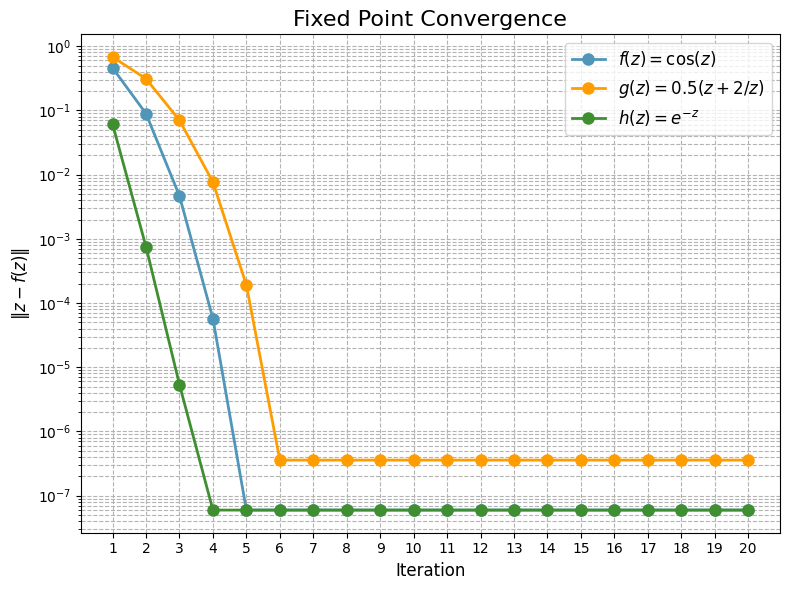

In [3]:
# Define your 1-dim DEQ!
deq = get_deq(f_solver='broyden', f_max_iter=20, f_tol=1e-6)

# The first equilibrium function
f = lambda z: torch.cos(z)
z0 = torch.tensor(0.0)
z_out, info = deq(f, z0)

f_abs_trace = info['abs_trace']
f_abs_trace = f_abs_trace.mean(dim=0)[1:]

# The second equilibrium function
g = lambda z: 0.5 * (z + 2 / z)
z0 = torch.tensor(0.5)
z_out, info = deq(g, z0)

g_abs_trace = info['abs_trace']
g_abs_trace = g_abs_trace.mean(dim=0)[1:]

# The third equilibrium function
h = lambda z: torch.exp(-z)
z0 = torch.tensor(0.5)
z_out, info = deq(h, z0)

h_abs_trace = info['abs_trace']
h_abs_trace = h_abs_trace.mean(dim=0)[1:]

# Convergence Visualization
iterations = np.arange(len(f_abs_trace))+1

plt.figure(figsize=(8, 6))

plt.plot(iterations, f_abs_trace, 'o-', color='#4f96b8', markersize=8, linewidth=2, label='$f(z) = \cos(z)$')
plt.plot(iterations, g_abs_trace, 'o-', color='#ff9d00', markersize=8, linewidth=2, label='$g(z) = 0.5(z + 2/z)$')
plt.plot(iterations, h_abs_trace, 'o-', color='#3f8f31', markersize=8, linewidth=2, label='$h(z) = e^{-z}$')

plt.grid(True, which="both", ls="--", c='0.7')
plt.xlabel('Iteration', fontsize=12)
plt.ylabel('$\|z - f(z)\|$', fontsize=12)
plt.yscale('log')
plt.xticks(iterations)

plt.title('Fixed Point Convergence', fontsize=16)
plt.legend(loc='best', fontsize=12)
plt.tight_layout()

plt.show()

### Multi-Variable Fixed Point Systems

In some cases, the fixed point system consists of multiple variables with different meanings and tensor shapes for each variable. For these cases, you don't need any further adjustments. Again, define the equilibrium function `f` that processes multiple variables and pass it to the `deq` layer with the initialization variables as follows. TorchDEQ will adapt to the multi-variable fixed point systems in the backend.

```
z_out, info = deq(f, (a0, b0, c0))
```

Fixed point error on a: tensor(5.9605e-08)
Fixed point error on b: tensor(0.)
Fixed point error on c: tensor(8.9407e-08)


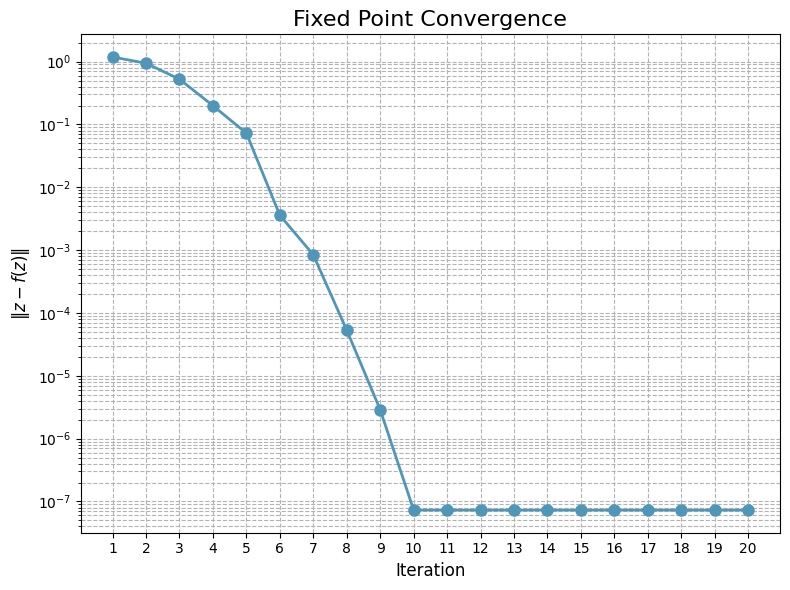

In [ ]:
# Let's try a multi-variable DEQ!
deq = get_deq(f_solver='broyden', f_max_iter=20, f_tol=1e-6)

# Mutil-variable equilibrium function
f = lambda a, b, c: (
    torch.cos(a) + 0.5 * b,
    torch.exp(-b) - torch.pow(c, 0.5),
    a - torch.sin(c)
)
a0, b0, c0 = torch.tensor(0.0), torch.tensor(0.0), torch.tensor(0.0)
z_out, info = deq(f, (a0, b0, c0))

# Fixed point errors
a, b, c = z_out[-1]
f_a, f_b, f_c = f(a, b, c)
print('Fixed point error on a:', (a - f_a).abs())
print('Fixed point error on b:', (b - f_b).abs())
print('Fixed point error on c:', (c - f_c).abs())

f_abs_trace = info['abs_trace']
f_abs_trace = f_abs_trace.mean(dim=0)[1:]

# Convergence Visualization
plt.figure(figsize=(8, 6))

iterations = np.arange(len(f_abs_trace))+1
plt.plot(iterations, f_abs_trace, 'o-', color='#4f96b8', markersize=8, linewidth=2)

plt.grid(True, which="both", ls="--", c='0.7')
plt.xlabel('Iteration', fontsize=12)
plt.ylabel('$\|z - f(z)\|$', fontsize=12)
plt.yscale('log')
plt.xticks(iterations)

plt.title('Fixed Point Convergence', fontsize=16)
plt.tight_layout()

plt.show()

### Backpropagation

DEQ models have various unique features. One of them is memory-efficient backpropagation via implicit differentiation. However, manually coding and debugging implicit differentiation is usually complex and time-consuming.

This is a long-standing challenge in DEQ models. To tackle this issue, TorchDEQ, as an integrated library, supports automatic differentiation for DEQ models. The outcome is that the `deq` layer is much more like an **operator** in the Deep Learning system, having both forward and backward passes. Code built upon this operator would no longer worry about differentiating through the fixed point system, as the return tensors are tracked gradient automatically.

#### Implicit Differentiation (IFT)

Here is an example of backpropagation through the Implicit Function Theorem (IFT). Passing `ift=True` to `get_deq` will enable implicit differentiation as the backward pass by solving this linear fixed point system.

\begin{equation}
\mathbf{g}^\star = \mathbf{g}^\star \frac{∂ f}{∂ \mathbf{z}^\star} + \frac{d L}{d \mathbf{z}^\star}.
\end{equation}

The configurations of the backward solver can be customized similarly to the forward solver. In this example, we compute loss directly on the fixed point returned from the `deq` layer. TorchDEQ will accomplish the IFT backward pass along with the Pytorch auto differentiation engine.

In [ ]:
deq = get_deq(
    ift=True,
    f_solver='broyden', f_max_iter=10, f_tol=1e-6,
    b_solver='broyden', b_max_iter=10, b_tol=1e-6
    )

# Input Injection & Equilibrium function
x = torch.tensor(1.0)
theta = torch.tensor(0.0, requires_grad=True)
f = lambda z: x * torch.cos(z) + theta

z0 = torch.tensor(0.0)
z_out, info = deq(f, z0)

tgt = torch.tensor(0.5)
loss = (z_out[-1] - tgt).abs().mean()
loss.backward()

print('Loss & Grad through IFT:', loss.item(), theta.grad)

Loss & Grad through IFT: 0.2390851378440857 tensor(0.5975)


#### Phantom Gradient (PG)

TorchDEQ also supports inexact gradients like Phantom Gradient as the backward pass, which replaces $(I - \frac{∂ f}{∂ \mathbf{z}^\star})^{-1} \frac{d f}{d θ}$ by a series that converge to it.

\begin{equation}
  \frac{d L}{d θ} = \frac{d L}{d \mathbf{z}^\star} (I - \frac{∂ f}{∂ \mathbf{z}^\star})^{-1} \frac{∂ f}{∂ θ} ≈ \frac{d L}{d \mathbf{z}^\star} A.
\end{equation}

For instance, the gradient chain can be computed from a damped solver at the fixed point.

\begin{equation}
  \mathbf{z}^\star = \tau * f(\mathbf{z}^\star, \mathbf{x}) + (1 - \tau) * \mathbf{z}^\star
\end{equation}

As a fast approximate backpropagation method for implicit models, phantom gradients showed sound training stability and generalization abilities. We set the zeroth-order approximation, i.e., 1-step gradient, as the default backpropagation option in TorchDEQ. (It is termed as 1-step grad, because this is equivalent to running 1 function step at the fixed point and differentiating it as the backward pass.)

\begin{equation}
  \frac{d L}{d θ} ≈ \frac{d L}{d \mathbf{z}^\star} \frac{∂ f}{∂ θ}.
\end{equation}

The default choice for the backward pass is `grad=1` for 1-step grad. Adjusting `grad=k` can utilize higher-order phantom gradients as the backward pass. Furthermore, enabling `ift=True` will overwrite this approximate gradient option and replace it with the (exact) implicit differentiation.


In [ ]:
deq = get_deq(grad=10)

# Input Injection & Equilibrium function
x = torch.tensor(1.0)
theta = torch.tensor(0.0, requires_grad=True)
f = lambda z: torch.cos(z) + theta

z0 = torch.tensor(0.0)
z_out, info = deq(f, z0)

tgt = torch.tensor(0.5)
loss = (z_out[-1] - tgt).abs().mean()
loss.backward()

print('Loss & Grad through Phantom Grad:', loss.item(), theta.grad)

Loss & Grad through Phantom Grad: 0.23907887935638428 tensor(0.5860)


#### Back Propagation Through Time (BPTT)

As a classic choice for differentiating through iterative computational graphs, the Back Propagation Through Time (BPTT) algorithm is also supported in TorchDEQ. It can be understood as a special case of Phantom Gradient, by zeroing out the forward solver `f_max_iter=0`. Then, all the gradient steps are taken by the PyTorch auto differentiation engine to compute gradients.

In our case, BPTT at 100 steps converges to the implicit gradient shown in the above code block. This is a sanity check for our implicit differentiation as well.

In [ ]:
deq = get_deq(grad=10, f_max_iter=0)

# Input Injection & Equilibrium function
x = torch.tensor(1.0)
theta = torch.tensor(0.0, requires_grad=True)
f = lambda z: torch.cos(z) + theta

z0 = torch.tensor(0.0)
z_out, info = deq(f, z0)

tgt = torch.tensor(0.5)
loss = (z_out[-1] - tgt).abs().mean()
loss.backward()

print('Loss & Grad at BPTT-10 :', loss.item(), theta.grad)


deq = get_deq(grad=100, f_max_iter=0)

# Input Injection & Equilibrium function
x = torch.tensor(1.0)
theta = torch.tensor(0.0, requires_grad=True)
f = lambda z: torch.cos(z) + theta

z0 = torch.tensor(0.0)
z_out, info = deq(f, z0)

tgt = torch.tensor(0.5)
loss = (z_out[-1] - tgt).abs().mean()
loss.backward()

print('Loss & Grad at BPTT-100:', loss.item(), theta.grad)

Loss & Grad at BPTT-10 : 0.23140406608581543 tensor(0.5414)
Loss & Grad at BPTT-100: 0.2390851378440857 tensor(0.5975)


### Trajectory Sampling


In some cases, if you want to monitor convergence or apply losses to the trajectory variables, you may need to collect the solver trajectory, i.e., solver states at some steps. For example, here, we want to visualize the solver states at the 3rd, 6th, and 9th solver steps, respectively. You can pass `indexing=[3,6,9]` to `get_deq` to achieve this goal. Then, the output `z_out` will include tensors from the 3rd, 6th, and 9th solver steps and the fixed point solution.

In general, you can imagine that this strategy offers **a series that converges to $\mathbf{z}^\star$**. The internal states are tracked gradients automatically as well. We only support phantom gradients on the sampled trajectories as they are coarse fixed point estimations. You can adjust the phantom gradient for each sampled state by setting `grad=[1,2,3]`, for instance.

In this case, we index the solver trajectories and visualize how the numerical solver converges to the fixed point.


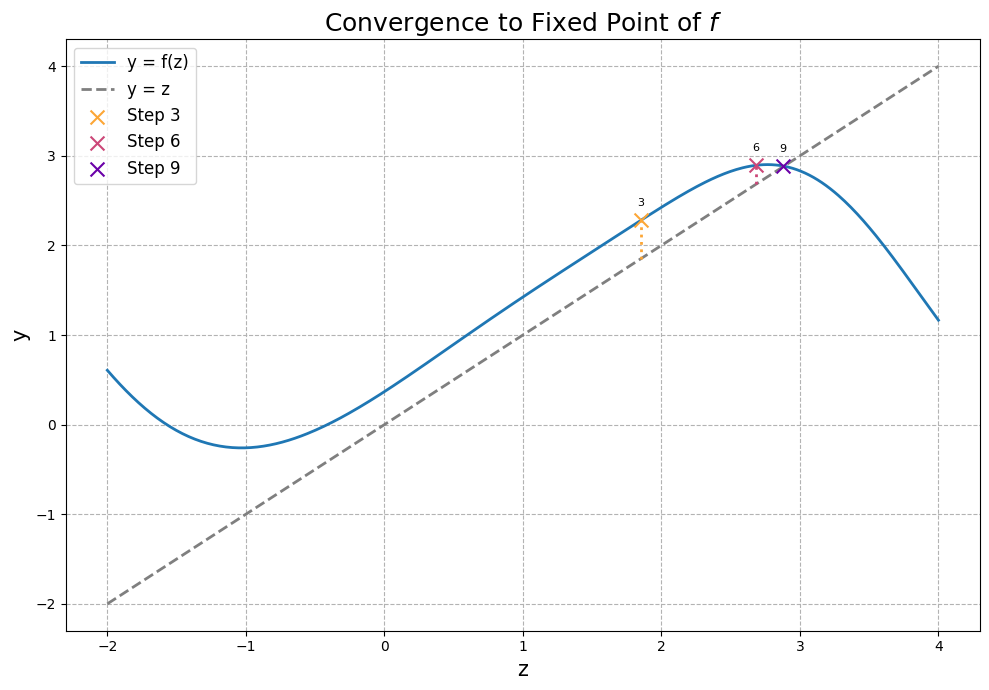

In [ ]:
# Define a DEQ to sample the solver trajectories
steps = [3, 6, 9]
deq = get_deq(core='indexing', f_solver='broyden', f_max_iter=20, f_tol=1e-6, indexing=steps)

# Input Injection & The Equilibrium function
x = torch.tensor(1.0)
f = lambda z: x*torch.exp(-torch.cos(z)) + torch.sin(z)

# Solving for the fixed point
z0 = torch.tensor(1.0)
z_out, info = deq(f, z0)

# Obtain solver trajectories
n_steps = len(steps)
convergence_path = z_out[:n_steps]

# Generate data points for the function curve
z_values = torch.linspace(-2, 4, 400)
f_values = f(z_values)

# Plotting and annotating the convergence trajectories
plt.figure(figsize=(10, 7))
plt.plot(z_values, f_values, label='y = f(z)', linewidth=2, color='C0')
plt.plot(z_values, z_values, '--', label='y = z', linewidth=2, color='C7')

colors = plt.cm.plasma(np.linspace(0.8, 0.2, n_steps))

for i, (z, step) in enumerate(zip(convergence_path, steps)):
    f_val = f(z).item()
    plt.scatter(z, f_val, color=colors[i], s=100, zorder=5, marker='x', label=f'Step {step}')
    plt.annotate(f'{step}', (z, f_val), textcoords="offset points", xytext=(0,10), ha='center', fontsize=8)
    plt.vlines(z, z, f_val, color=colors[i], linestyles="dotted", linewidth=2)

plt.title('Convergence to Fixed Point of $f$', fontsize=18)
plt.xlabel('z', fontsize=15)
plt.ylabel('y', fontsize=15)
plt.grid(True, which="both", ls="--", c='0.7')
plt.legend(loc='best', fontsize=12)
plt.tight_layout()

plt.show()

## A real-world model: DEQ-INR

### Implicit Neural Representation (INR)

<img src="https://drive.google.com/uc?id=1UHulB5U1Qkw4djIubDPKTPFlS3U7fEsJ">

Implicit Neural Representations (INR) employ a small neural network to map the coordinate systems like the $(x, y)$ in the 2D space to its corresponding properties like the RBG values $(r, g, b)$. A single INR can store the representation of a given image in the 2D space, object, or scene in the 3D space in an infinite resolution. They are different from classic data compression formats like JPEG. While discrete representations store the information in a table that can be directly indexed based on the exact grid position, INR provides a continuous representation with infinite resolution, i.e., they can be indexed through irregular grid systems or positions.

### DEQ-INR

This implicit neural representation, like Siren [1], can be parameterized as an explicit model like a tiny MLP equipped with periodical activations, e.g., the `sin` function. It can be an implicit model, too, i.e., Implicit Layers for Implicit Representations [2], or DEQ-INR. The difference is that DEQ-INR maps the input grid $(x, y)$ to an RGB value $(r,g,b)$ based on the fixed points of the periodical MLP layer.

As demonstrated in the following experiments, DEQ-INR can be highly parameter efficient in storing image data. Using the same parameters, DEQ-INR achieves a much higher PSNR value (which measures the quality of reconstruction. The higher, the better.).

We implement both DEQ-INR and explicit INR using a joint Base class. Because of TorchDEQ's modular design, this Base class can be very simple and structured. We only need to add a single line to call a DEQ layer from TorchDEQ, which greatly eases the usage of deep equilibrium models.

We also support fixed point reuse that initializes the fixed point computation via the previous fixed point to accelerate the fixed point convergence in the training time.

Our implemented DEQ-INR, paired with phantom gradient [3] and fixed point reuse [2,4], **outperforms the IFT training for DEQ by 6 times in training speed** and **surpasses the explicit INR model by 14% in terms of PSNR**, using the same base model and the same amount of parameters.

[1] Sitzmann, Vincent, Julien Martel, Alexander Bergman, David Lindell, and Gordon Wetzstein. "Implicit neural representations with periodic activation functions." Advances in Neural Information Processing Systems (2020)

[2] Huang, Zhichun, Shaojie Bai, and J. Zico Kolter. "$(\textrm {Implicit})^ 2$: Implicit Layers for Implicit Representations." Advances in Neural Information Processing Systems (2021)

[3] Geng, Zhengyang, Xin-Yu Zhang, Shaojie Bai, Yisen Wang, Zhouchen Lin. "On Training Implicit Models." Advances in Neural Information Processing Systems (2021)

[4] Bai, Shaojie, Zhengyang Geng, Yash Savani, and J. Zico Kolter. Deep equilibrium optical flow estimation. In Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition (CVPR), 2022.

#### Note

Before running the following blocks, we suggest restarting the Runtime to clear the memory and connect to a T4 GPU instance.

In [ ]:
import numpy as np

import torch
import torch.nn as nn

from torchdeq import get_deq
from torchdeq.norm import apply_norm, reset_norm

######################################
#
# Linear Layers
#
######################################

class INRInjection(nn.Linear):
  def __init__(self, in_features, d_hidden, scale=256):
    super().__init__(in_features, d_hidden)
    self.weight.data *= scale
    self.bias.data.uniform_(-np.pi, np.pi)


class MFNLinear(nn.Linear):
  def __init__(self, d_hidden, scale=256):
    super().__init__(d_hidden, d_hidden)
    nn.init.uniform_(self.weight, -np.sqrt(1 / d_hidden), np.sqrt(1 / d_hidden))

######################################
#
# DEQ-INR Base class
#
######################################

class DEQINRBase(nn.Module):
  def __init__(self, d_in=2, d_out=3, d_hidden=128, n_layer=1, scale=256.,
          deq_mode=True, **kwargs):
    super().__init__()

    self.inj = INRInjection(d_in, d_hidden*(n_layer+1), scale=scale)
    self.mfn = nn.ModuleList([
        MFNLinear(d_hidden, d_hidden) for _ in range(n_layer)
        ])
    self.out = nn.Linear(d_hidden, d_out)

    self.d_hidden = d_hidden
    self.n_layer  = n_layer

    self.register_buffer('z_aux', self._init_z())
    self.deq_mode = deq_mode
    self.deq = get_deq(**kwargs)

    # This function automatically decorates weights in your DEQ layer
    # to have weight/spectral normalization. (for better stability)
    # Using norm_type='none' in `kwargs` can also skip it.
    apply_norm(self.mfn, **kwargs)

  def _init_z(self):
    raise NotImplemented

  def injection(self, x):
    raise NotImplemented

  def filter(self, z, u):
    raise NotImplemented

  def mfn_forward(self, z, u):
    # Fixed point reuse
    z = z + self.filter(self.z_aux, u[0])

    for i, layer in enumerate(self.mfn):
      z = self.filter(layer(z), u[i+1])

    return z

  def forward(self, x, z=None):
    reuse = True
    if z is None:
      z = torch.zeros(x.shape[0], self.d_hidden).to(x)
      reuse = False

    u = self.injection(x)

    reset_norm(self.mfn)
    f = lambda z: self.mfn_forward(z, u)
    if self.deq_mode:
      solver_kwargs = {'f_max_iter':0} if reuse else {}
      z_pred, info = self.deq(f, z, solver_kwargs=solver_kwargs)
    else:
      z_pred = [f(z)]

    outputs = [self.out(z) for z in z_pred]

    return outputs, z_pred[-1]

### Filters of DEQ-INR

We implement two types of filters as the instantiations of our DEQ-INR Base class. One using the Siren-alike additive filter [1]. The other leverages the Fourier-type multiplicative filter design in the MFN [2].

\begin{align}
\mathbf{z}^\star     & = \text{Sin}\left(\mathbf{W} \mathbf{z}^\star + U(\mathbf{x}) + \mathrm{b} \right) & [1] \\
\mathbf{z}^\star     & = (\mathbf{W} \mathbf{z}^\star + \mathrm{b}) \circ \text{Filter}\left(U(\mathbf{x}) \right) & [2]
\end{align}

where $\text{Sin}$ is the sinusoidal activation function, and Filter represents the Fourier filter or Gabor filter.

Through the structured DEQ-INR Base class design, we only need to write three functions for those two instantiations, including the initialization method, the filter itself, and the input injection.

[1] Sitzmann, Vincent, Julien Martel, Alexander Bergman, David Lindell, and Gordon Wetzstein. "Implicit neural representations with periodic activation functions." Advances in Neural Information Processing Systems 33 (2020)

[2] Fathony, Rizal, Anit Kumar Sahu, Devin Willmott, and J. Zico Kolter. "Multiplicative filter networks." In International Conference on Learning Representations. 2020.

In [ ]:
######################################
#
# DEQ-INR Instantiations by different filters
#
######################################

class DEQSirenINR(DEQINRBase):
  def __init__(self, d_in=2, d_out=3, d_hidden=128, n_layer=1, scale=256.,
          deq_mode=True, **kwargs):
    super().__init__(d_in, d_out, d_hidden, n_layer, scale, deq_mode, **kwargs)

  def _init_z(self):
    return torch.zeros(1, self.d_hidden)

  def injection(self, x):
    u = self.inj(x)
    u = u.chunk(self.n_layer+1, dim=1)

    return u

  def filter(self, z, u):
    return torch.sin(z + u)


class DEQFourierINR(DEQINRBase):
  def __init__(self, d_in=2, d_out=3, d_hidden=128, n_layer=1, scale=256.,
          deq_mode=True, **kwargs):
    super().__init__(d_in, d_out, d_hidden, n_layer, scale, deq_mode, **kwargs)

  def _init_z(self):
    return torch.ones(1, self.d_hidden)

  def injection(self, x):
    u = torch.sin(self.inj(x))
    u = u.chunk(self.n_layer+1, dim=1)

    return u

  def filter(self, z, u):
    return z * u


_model_class = {
  'Fourier': DEQFourierINR,
  'Siren': DEQSirenINR
}


def get_model(filter):
  assert filter in _model_class
  return _model_class[filter]

### Memory Usage

DEQ models are also know for its memory efficient backpropagation mechanism. The implicit function theorem allows for $O(1)$ memory complexity for differentiating through the fixed point system.


The model we test on the Colab GPU is a $256$-d DEQ-INR over a $512×512$ input grid, which means the tiny DEQ-INR network is activated by 262144 times simultaneously in a single batch! All the activations take less than 2GB GPU memory. It is a pretty good memory efficiency here.

In [ ]:
# DEQ INR w/ 1-step grad
x = torch.rand(512*512, 2).cuda()
model = DEQSirenINR(d_in=2, d_out=3, d_hidden=256, n_layer=1, scale=256.,
                    deq_mode=True, grad=1).cuda()
out, z = model(x)

torch.cuda.empty_cache()
!nvidia-smi
del model, out, z

Sat Sep 23 05:07:48 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0    60W /  70W |   1175MiB / 15360MiB |    100%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Explicit INR
x = torch.rand(512*512, 2).cuda()
model = DEQSirenINR(d_in=2, d_out=3, d_hidden=256, n_layer=1, scale=256.,
                    deq_mode=False).cuda()
out, z = model(x)

torch.cuda.empty_cache()
!nvidia-smi
del model, out, z

Sat Sep 23 05:07:49 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0    48W /  70W |   1175MiB / 15360MiB |     11%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# DEQ INR w/ IFT
x = torch.rand(512*512, 2).cuda()
model = DEQFourierINR(d_in=2, d_out=3, d_hidden=256, n_layer=1, scale=256.,
                      deq_mode=True, ift=True).cuda()
out, z = model(x)

torch.cuda.empty_cache()
!nvidia-smi
del model, out, z

Sat Sep 23 05:07:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0    60W /  70W |   1943MiB / 15360MiB |    100%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Ablation Study on Training Efficiency

Having the model components for implicit representation, we can now build the training pipeline to compress an image into INR/DEQ-INR within **1 minute** on the cloud GPU. Come to train your first DEQ model!

Using a series of techniques, training an "infinite-depth" DEQ model is almost the same speed as the standard INR baseline, while demonstrating a considerably higher reconstruction quality. Such techniques are 1) reuse of fixed point $\mathbf{z}^\star$ from the previous step and 2) inexact gradient. We also provide an ablation study on the DEQ framework and different techniques to understand their effectiveness for learning implicit representation.

We used an input size of 256$\times$256 and a hidden unit size of 256. The resulting compression rate (i.e., model_size / img_size) is 0.346. We conduct ablation studies for DEQ-INR and INR using different training methods and settings, as shown below. Thanks to TorchDEQ and our structured implementation for INR, turning from one to another only requires changing the configuration line.

| Setting      | Training Iters | Total Time (s) | PSNR (dB) |
| ------------ | :------------: | :--------: | :-------: |
| INR | 500  | 36  | 28.09 |
| INR | 5000 | 391 | 29.16 |
| DEQ-INR w/ PG & Reuse | 500 | 37  | 32.48 |
| DEQ-INR w/ PG         | 500 | 268 | 32.43 |
| DEQ-INR w/ IFT (Broyden solver, 10 max-iter) | 500 | 435  | 32.17 |
| DEQ-INR w/ IFT (Broyden solver, 40 max-iter) | 500 | 2170 | 33.33 |

In the end, we also train DEQ-INR and INR on an image size of 512$\times$512 and compression rate of 0.256 to illustrate high-resolution image reconstruction.

The results indicate that the DEQ model offers significant parameter efficiency and model capacity for learning implicit representation. In addition, the combination of the phantom gradient (PG) and the fixed point reuse (Reuse) accelerates DEQ-INR training by 10$\times$ and offers the same performance as the IFT training.

### Qualitative Evaluation of DEQ-INR

We also evaluate the result of training DEQ-INR by representing the visual results of the trained DEQ-INR via our implementations.

We compared the results of two examples (one gray-scale and one RGB image) reconstructed from DEQ-INR with acceleration techniques mentioned above and those from vanilla INR training.

<img src="https://drive.google.com/uc?id=134e3FpQJ8csyM2k9hrgO9fffmmhC4OJI">
<img src="https://drive.google.com/uc?id=1RjA9tG2aFPb7INdF0frYrlloYI7pISiz">

The qualitative comparison demonstrates that our implementation of DEQ-INR better compressed the ground-truth images compared to the vanilla INR building from an explicit model.

### Training pipeline of DEQ-INR

First, import all the packages needed for training and visualization.

In [ ]:
import numpy as np

import skimage
import matplotlib.pyplot as plt
from tqdm import tqdm

import torch
from torchdeq import get_deq
from torchdeq.loss import fp_correction

Define the data preprocessing and postprocessing operations. These two functions transform NumPy arrays into tensors while normalizing them or transform tensors back to NumPy arrays while clipping the invalid values.

In [ ]:
# Normalize input np.array
# Convert np.array to tensor
def preprocess(x, normalize=False, device=None, dtype=None):
  if normalize:
      x = 2 * x - 1
  B, H, W, C = x.shape

  x = torch.tensor(x, device=device).float()
  return x.reshape(B*H*W, C)


# Convert tensor to np.array
# Clip min/max values
def postprocess(x):
  return torch.clip((x.detach() + 1)/2, 0, 1)


# Calculate PSNR
def PSNR(y_orig, y_pred):
  mse = torch.mean((y_orig - y_pred) ** 2)
  max_pixel = 1.0
  psnr = 20 * torch.log10(max_pixel / torch.sqrt(mse))
  return psnr.item()

Define the `load_data` function that provides the standard benchmarking data for training INR. We load a greyscale image Camera Man and a color image Astronaut from `skimage` and preprocess them. They provide per location $(r,g,b)$ values as the targets of INR training.

In [ ]:
def load_data(img, grid_size, device=None, show_img=True):
  # Load image
  if img == 'astronaut':
    image = skimage.data.astronaut()
    dataset = image.reshape(1, 512, 512, 3).astype(np.float32) / 255
  else:
    image = skimage.data.camera()
    dataset = image.reshape(1, 512, 512, 1).astype(np.float32) / 255

  data_channels = dataset.shape[-1]
  RES = image.shape[1]

  full_x = np.linspace(0, 1, RES) * 2 - 1
  full_x_grid = np.stack(np.meshgrid(full_x,full_x), axis=-1)[None, :, :]

  # Downsampling
  x_train_data = x_test_data = full_x_grid[:, ::RES // grid_size, ::RES // grid_size]
  y_train_data = y_test_data = dataset[:, ::RES // grid_size, ::RES // grid_size]
  print("Shape of x_train", x_train_data.shape)
  print("Shape of y_train", y_train_data.shape)

  # Visualize the image if requested
  if show_img:
    fig, ax = plt.subplots(1, 3, figsize=(10, 3))
    if img == 'astronaut':
      ax[0].imshow(y_train_data[0, :, :, :])
    else:
      ax[0].imshow(y_train_data[0, :, :, 0], cmap='gray')
    ax[0].set_title("image")
    ax[0].axis('off')
    ax[1].imshow(x_train_data[0, :, :, 0])
    ax[1].set_title("horizontal mesh_grid")
    ax[1].axis('off')
    ax[2].imshow(x_train_data[0, :, :, 1])
    ax[2].set_title("vertical mesh_grid")
    ax[2].axis('off')

  # Transform to tensors
  x_train = preprocess(x_train_data, device=device)
  y_train = preprocess(y_train_data, normalize=True, device=device)

  return x_train, y_train


#### Fixed Point Reuse and Beyond

The main training loop for DEQ-INR/INR. We support training DEQ-INR and standard INR models, plus fixed point reuse for DEQ-INR.

The assumption for fixed point reuse is that a small change in the model weight $\theta \to \theta + \Delta \theta$ will only shift the fixed point $\mathbf{z}^\star_{\theta + \Delta \theta}$ from $\mathbf{z}^\star_{\theta}$ by a little under the same input $\mathbf{x}$, i.e.,

\begin{equation}
  \| \mathbf{z}^\star_{\theta + \Delta \theta} - \mathbf{z}^\star_{\theta}\| \leq L \| \Delta \theta \|
\end{equation}

where $\mathbf{z}^\star_{\theta + \Delta \theta} = f_{\theta + \Delta \theta}(\mathbf{z}^\star_{\theta + \Delta \theta}, x)$ and $\mathbf{z}^\star_{\theta} = f_{\theta}(\mathbf{z}^\star_{\theta}, x)$.

A small perturbation (w.r.t either $\theta$ or $\mathbf{x}$) should not change the fixed point that much. Given this assumption, we can initialize the solver using the fixed point $\mathbf{z}^\star$ solved from the previous iterations, which saves lots of computations from the forward solver and accelerates the training. For the backward pass, phantom gradients also shorten the gradient computation.

Altogether, as an "infinite-layer" network (we use the term "infinite-layer" because the fixed point layer is the extrapolation of classic network hierarchy $\mathbf{z}_{L+1} = f(\mathbf{z}_{L})$ at infinite depth $L$), DEQ-INR can have almost the same training speed as the standard INR, while offering a considerably better reconstruction quality!

Try it by yourself!

#### Random Thoughts

- Given the hypothesis that a small perturbation on weights $\theta$ will cause a slight change in the forward fixed point $\mathbf{z}^\star$, what about the change of the fixed point $\mathbf{g}^\star$ in the backward pass?
Ideally, having the same input $\mathbf{x}$ and target $\mathbf{y}$, the change over the backward fixed point should also be bounded.
Thus, reusing the backward fixed point $\mathbf{g}^\star$ is worthing thinking, which provides a new accelerated approach for learning DEQs besides inexact gradients. (This method is also not included in this Colab demo.)


- **For a high-level discussion, the fixed point can be construed as the DEQ's "memory" of the input $\mathbf{x}$.** Beyond leveraging fixed points for computational efficiency, exploring the patterns concealed within them is highly meaningful. This aspect marks a significant advantage and difference of implicit models over classical approaches. They are not limited to generating representations; they can also encapsulate information within the fixed points. Through the inherent dynamics, this information can be extracted or reused, broadening the models' utility and efficiency.

In [ ]:
def train(model, x_train, y_train, lr=1e-3, log_freq=100):
  # Compute compression rate
  n_params = sum(p.numel() for p in model.parameters())
  img_size = y_train.numel()
  print(f'Model Parameters: {n_params:,}')
  print(f'Img Size: {img_size:,}')
  print(f'Compression ratio: {n_params/img_size:.3f}')

  # Training loop
  optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=0.0)
  scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs, eta_min=1e-6)

  loss_log, psnr_log = [], []

  z_star = None
  for i in tqdm(range(epochs)):
    y_pred, z_pred = model(x_train, z_star)
    if deq_mode and reuse:
      z_star = z_pred.detach()

    # If you use trajectory sampling, fp_correction automatically
    # aligns the tensors and applies your loss function.
    loss_fn = lambda y_gt, y: ((y_gt - y) ** 2).mean()
    train_loss = fp_correction(loss_fn, (y_train, y_pred))

    train_loss.backward()
    optimizer.step()
    scheduler.step()

    loss_log.append(train_loss.item())

    train_psnr = PSNR(postprocess(y_train), postprocess(y_pred[-1]))
    psnr_log.append(train_psnr)
    if (i+1) % log_freq == 0:
      with torch.inference_mode():
        y_pred, _ = model(x_train)
      psnr = PSNR(postprocess(y_train), postprocess(y_pred[-1]))
      print(f"[Train] Loss: {train_loss.item():.5f}, || PSNR: {psnr:.2f} || Lr: {scheduler.get_last_lr()}")

    optimizer.zero_grad()
  return y_pred[-1], loss_log, psnr_log

In [ ]:
def plot_training_stats(loss_log, psnr_log):
  fig, ax1 = plt.subplots()
  ax1.plot(loss_log, color='orange', label='Train Loss')
  ax1.set_xlabel("epoch")
  ax1.semilogy()

  ax2 = ax1.twinx()
  ax2.plot(psnr_log, color='b', label='PSNR')
  plt.title("training curve")

  ax1.legend(loc='best')
  ax2.legend(loc='best')

In [ ]:
def visualize_results(y_orig, y_pred, grid_size=128):
  y_orig = postprocess(y_orig).detach().cpu().numpy()
  y_pred = postprocess(y_pred).detach().cpu().numpy()
  data_channels = y_orig.shape[-1]

  fig, ax = plt.subplots(1, 2, figsize=(10, 24))
  if data_channels == 1:
    ax[0].imshow(y_orig.reshape(grid_size, grid_size), cmap='gray')
    ax[1].imshow(y_pred.reshape(grid_size, grid_size), cmap='gray')
  else:
    ax[0].imshow(y_orig.reshape((grid_size, grid_size, data_channels)))
    ax[1].imshow(y_pred.reshape((grid_size, grid_size, data_channels)))

  ax[0].set_title("GT")
  ax[0].axis('off')
  ax[1].set_title("Reconstruction")
  ax[1].axis('off')

#### Run!

First, let's start with an INR using an explicit model design. This will offer an impression of how INR models work.

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


 21%|██        | 103/500 [00:06<00:28, 13.89it/s]

[Train] Loss: 0.01160, || PSNR: 25.67 || Lr: [0.009045180463377551]


 40%|████      | 201/500 [00:14<00:23, 12.76it/s]

[Train] Loss: 0.00849, || PSNR: 26.99 || Lr: [0.006545430463377552]


 60%|██████    | 301/500 [00:21<00:18, 10.82it/s]

[Train] Loss: 0.00756, || PSNR: 27.49 || Lr: [0.003455569536622448]


 80%|████████  | 401/500 [00:28<00:07, 12.82it/s]

[Train] Loss: 0.00725, || PSNR: 27.66 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [00:36<00:00, 13.87it/s]


[Train] Loss: 0.00721, || PSNR: 27.69 || Lr: [1e-06]


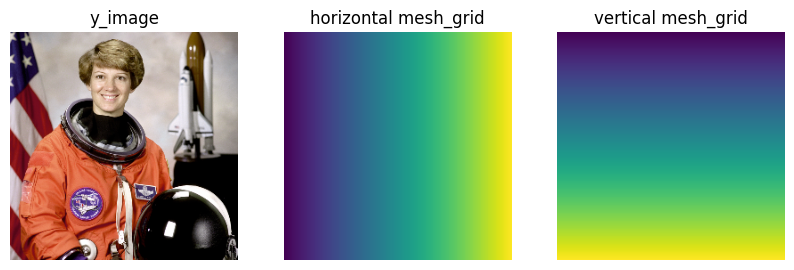

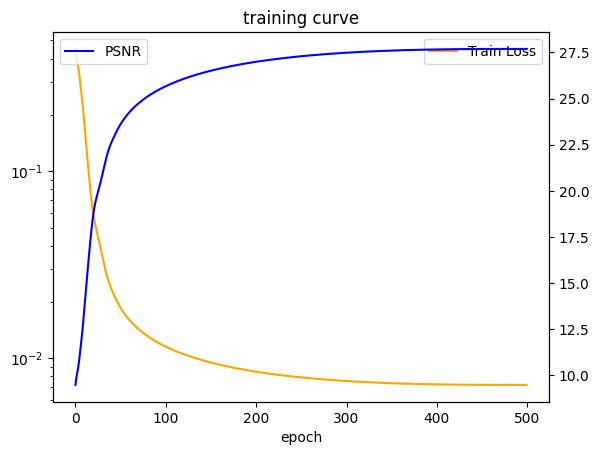

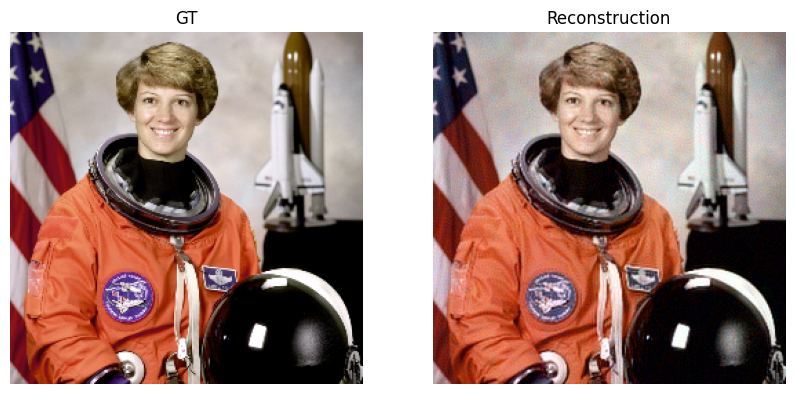

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
scale = 256.

deq_mode = False
reuse = False
ift = False
grad = 3
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

exp_y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, exp_y_pred, grid_size=grid_size)

For DEQ-INR, we can run an accelerated version first and then gradually ablate the components to understand their effectiveness.

This is a DEQ-INR model using the same base architecture design as the previous one, fixed point reuse, and phantom gradient. This model has the same training speed as the standard INR model while reaching *4 points* higher in terms of PSNR.

Please note that DEQ-INR and INR have different frequency biases. (This is also really interesting!) So we turned and chose the `scale` hyperparameter separately for them.

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


 20%|██        | 101/500 [00:07<00:57,  6.94it/s]

[Train] Loss: 0.00541, || PSNR: 28.92 || Lr: [0.009045180463377551]


 40%|████      | 201/500 [00:15<00:42,  7.09it/s]

[Train] Loss: 0.00327, || PSNR: 31.06 || Lr: [0.006545430463377552]


 60%|██████    | 301/500 [00:22<00:28,  7.07it/s]

[Train] Loss: 0.00293, || PSNR: 31.52 || Lr: [0.003455569536622448]


 80%|████████  | 401/500 [00:30<00:14,  7.02it/s]

[Train] Loss: 0.00252, || PSNR: 32.20 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [00:37<00:00, 13.20it/s]

[Train] Loss: 0.00246, || PSNR: 32.32 || Lr: [1e-06]


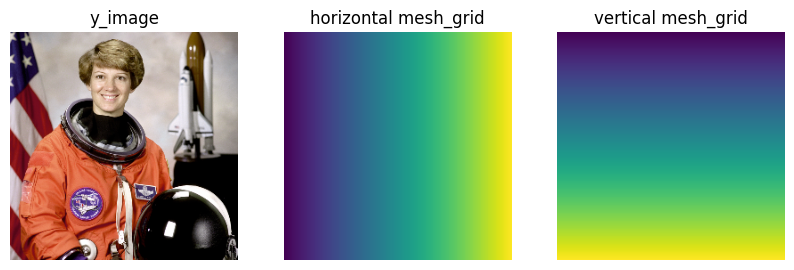

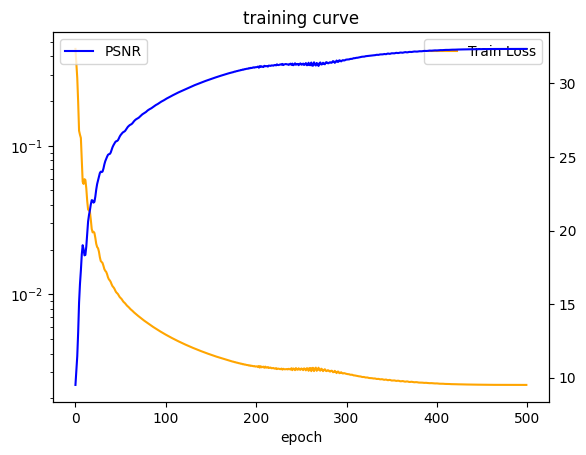

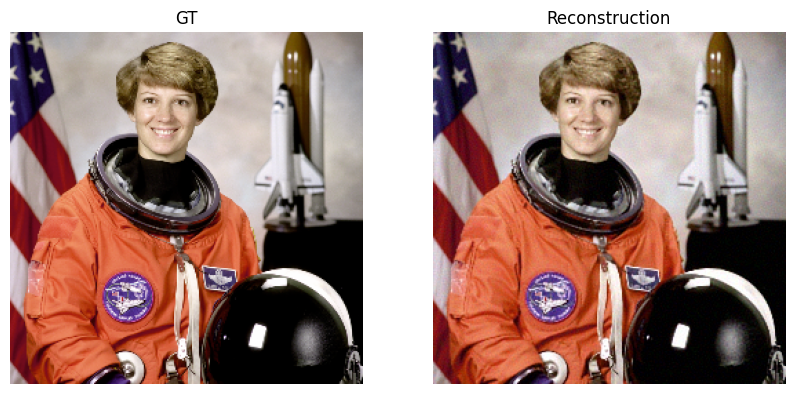

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
scale = 128.

deq_mode = True
reuse = True
ift = False
grad = 5
norm_type = 'spectral_norm'


device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, y_pred, grid_size=grid_size)

Now, we remove fixed point reuse from the previous setting. The reconstruction performance remains unchanged. However, the training speed falls $7\times$ slower! Wow! The fixed points really contain rich information!

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


 20%|██        | 100/500 [00:51<04:27,  1.49it/s]

[Train] Loss: 0.00543, || PSNR: 28.91 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [01:44<03:22,  1.48it/s]

[Train] Loss: 0.00332, || PSNR: 31.03 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [02:38<02:14,  1.49it/s]

[Train] Loss: 0.00267, || PSNR: 32.00 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [03:31<01:07,  1.49it/s]

[Train] Loss: 0.00247, || PSNR: 32.33 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [04:25<00:00,  1.88it/s]

[Train] Loss: 0.00244, || PSNR: 32.38 || Lr: [1e-06]


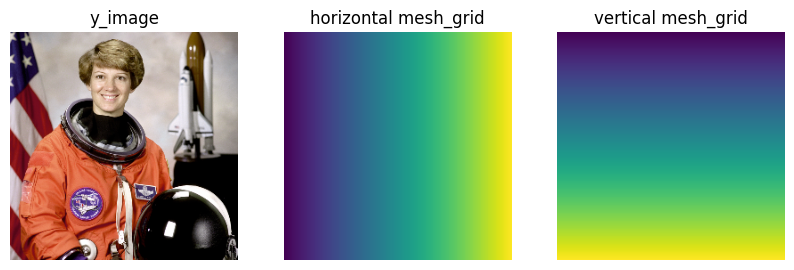

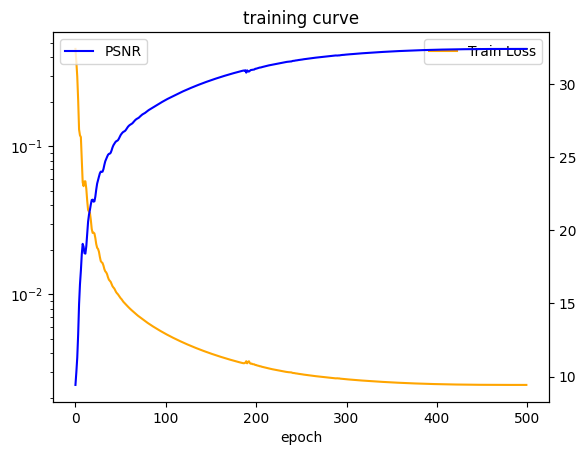

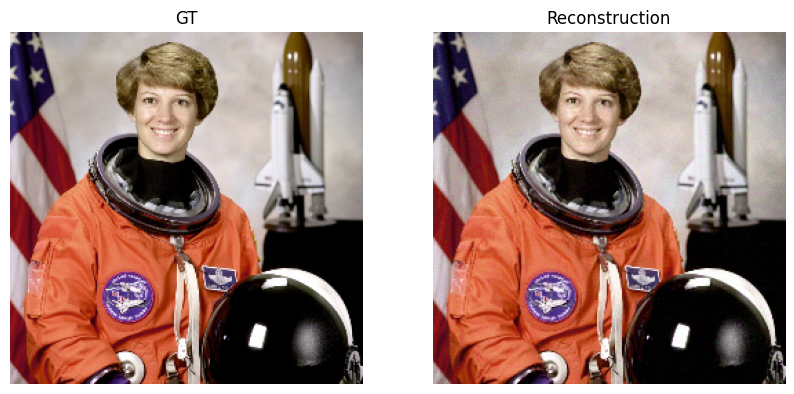

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
scale = 128.

deq_mode = True
reuse = False
ift = False
grad = 5
norm_type = 'spectral_norm'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, y_pred, grid_size=grid_size)

Next, we replace phantom gradients (PG) with implicit differentiation (IFT). Don't worry! Let's start with a lightweight version of IFT. This will reach a similar performance as inexact gradients, slowing down by $2\times$, however.

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


 20%|██        | 100/500 [01:21<06:48,  1.02s/it]

[Train] Loss: 0.00499, || PSNR: 29.28 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [02:52<05:11,  1.04s/it]

[Train] Loss: 0.00304, || PSNR: 31.46 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [04:22<03:28,  1.04s/it]

[Train] Loss: 0.00258, || PSNR: 32.16 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [05:53<01:44,  1.04s/it]

[Train] Loss: 0.00247, || PSNR: 32.36 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [07:24<00:00,  1.13it/s]

[Train] Loss: 0.00244, || PSNR: 32.40 || Lr: [1e-06]


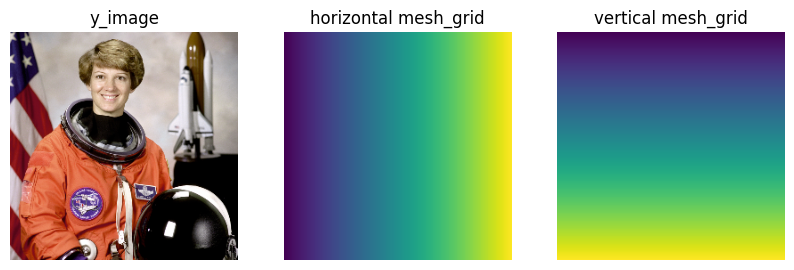

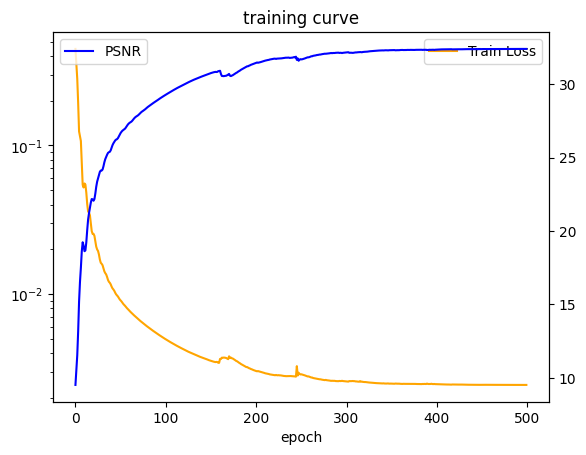

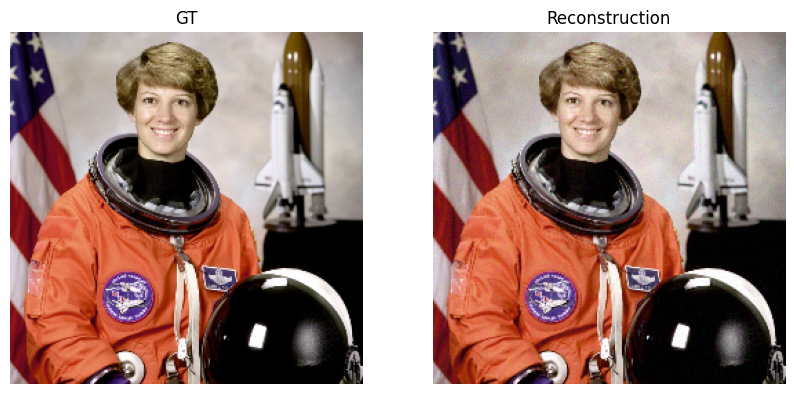

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
scale = 128.

deq_mode = True
reuse = False
ift = True
grad = 1
norm_type = 'spectral_norm'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type,
        f_solver='broyden', f_max_iter=10,
        b_solver='broyden', b_max_iter=10).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, y_pred, grid_size=grid_size)

As a comparison, we can also build a sufficiently trained INR baseline. This time, we annealed down the learning rate and used 5000 epochs. This baseline takes an even longer time than DEQ-INR trained by inexact gradients (w/o fixed point reuse) but still falls 3 points behind.

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


  2%|▏         | 102/5000 [00:07<06:18, 12.94it/s]

[Train] Loss: 0.07459, || PSNR: 17.46 || Lr: [0.0009990143508499215]


  4%|▍         | 202/5000 [00:14<06:10, 12.96it/s]

[Train] Loss: 0.01920, || PSNR: 23.46 || Lr: [0.0009960612933065816]


  6%|▌         | 302/5000 [00:22<05:56, 13.19it/s]

[Train] Loss: 0.01317, || PSNR: 25.11 || Lr: [0.0009911524817389807]


  8%|▊         | 402/5000 [00:29<05:49, 13.16it/s]

[Train] Loss: 0.01079, || PSNR: 25.96 || Lr: [0.0009843072889837508]


 10%|█         | 502/5000 [00:36<06:36, 11.35it/s]

[Train] Loss: 0.00940, || PSNR: 26.55 || Lr: [0.0009755527298894271]


 12%|█▏        | 602/5000 [00:44<05:36, 13.08it/s]

[Train] Loss: 0.00849, || PSNR: 26.98 || Lr: [0.0009649233547011794]


 14%|█▍        | 702/5000 [00:51<05:31, 12.96it/s]

[Train] Loss: 0.00785, || PSNR: 27.32 || Lr: [0.0009524611127067747]


 16%|█▌        | 802/5000 [00:58<05:14, 13.33it/s]

[Train] Loss: 0.00737, || PSNR: 27.59 || Lr: [0.0009382151866819082]


 18%|█▊        | 902/5000 [01:05<05:08, 13.26it/s]

[Train] Loss: 0.00700, || PSNR: 27.81 || Lr: [0.0009222417987882547]


 20%|██        | 1002/5000 [01:13<05:57, 11.17it/s]

[Train] Loss: 0.00671, || PSNR: 27.99 || Lr: [0.0009046039886902846]


 22%|██▏       | 1102/5000 [01:20<04:59, 13.01it/s]

[Train] Loss: 0.00647, || PSNR: 28.14 || Lr: [0.0008853713647665051]


 24%|██▍       | 1202/5000 [01:27<04:56, 12.81it/s]

[Train] Loss: 0.00628, || PSNR: 28.27 || Lr: [0.000864619829396994]


 26%|██▌       | 1302/5000 [01:35<04:49, 12.78it/s]

[Train] Loss: 0.00612, || PSNR: 28.38 || Lr: [0.000842431279411379]


 28%|██▊       | 1402/5000 [01:42<04:40, 12.82it/s]

[Train] Loss: 0.00599, || PSNR: 28.47 || Lr: [0.0008188932828794694]


 30%|███       | 1502/5000 [01:50<05:23, 10.83it/s]

[Train] Loss: 0.00587, || PSNR: 28.56 || Lr: [0.0007940987335200891]


 32%|███▏      | 1602/5000 [01:57<04:29, 12.60it/s]

[Train] Loss: 0.00577, || PSNR: 28.63 || Lr: [0.0007681454840920078]


 34%|███▍      | 1702/5000 [02:05<04:18, 12.75it/s]

[Train] Loss: 0.00569, || PSNR: 28.69 || Lr: [0.000741135960213806]


 36%|███▌      | 1802/5000 [02:12<04:06, 12.97it/s]

[Train] Loss: 0.00561, || PSNR: 28.75 || Lr: [0.0007131767561367523]


 38%|███▊      | 1902/5000 [02:20<04:07, 12.52it/s]

[Train] Loss: 0.00554, || PSNR: 28.81 || Lr: [0.0006843782140659952]


 40%|████      | 2002/5000 [02:27<04:31, 11.03it/s]

[Train] Loss: 0.00548, || PSNR: 28.85 || Lr: [0.0006548539886902845]


 42%|████▏     | 2102/5000 [02:35<03:42, 13.02it/s]

[Train] Loss: 0.00542, || PSNR: 28.90 || Lr: [0.0006247205986388429]


 44%|████▍     | 2202/5000 [02:42<03:41, 12.66it/s]

[Train] Loss: 0.00537, || PSNR: 28.94 || Lr: [0.0005940969666355678]


 46%|████▌     | 2302/5000 [02:49<03:29, 12.90it/s]

[Train] Loss: 0.00533, || PSNR: 28.97 || Lr: [0.0005631039501653688]


 48%|████▊     | 2402/5000 [02:57<03:19, 13.05it/s]

[Train] Loss: 0.00529, || PSNR: 29.01 || Lr: [0.000531863864504891]


 50%|█████     | 2502/5000 [03:05<03:46, 11.04it/s]

[Train] Loss: 0.00525, || PSNR: 29.04 || Lr: [0.0005004999999999988]


 52%|█████▏    | 2602/5000 [03:12<03:06, 12.88it/s]

[Train] Loss: 0.00521, || PSNR: 29.07 || Lr: [0.00046913613549510704]


 54%|█████▍    | 2702/5000 [03:19<02:56, 12.99it/s]

[Train] Loss: 0.00518, || PSNR: 29.09 || Lr: [0.00043789604983462884]


 56%|█████▌    | 2802/5000 [03:27<02:50, 12.89it/s]

[Train] Loss: 0.00515, || PSNR: 29.12 || Lr: [0.0004069030333644298]


 58%|█████▊    | 2902/5000 [03:34<02:42, 12.95it/s]

[Train] Loss: 0.00513, || PSNR: 29.14 || Lr: [0.0003762794013611542]


 60%|██████    | 3002/5000 [03:42<02:50, 11.70it/s]

[Train] Loss: 0.00510, || PSNR: 29.16 || Lr: [0.00034614601130971285]


 62%|██████▏   | 3102/5000 [03:49<02:28, 12.75it/s]

[Train] Loss: 0.00508, || PSNR: 29.18 || Lr: [0.0003166217859340027]


 64%|██████▍   | 3202/5000 [03:57<02:19, 12.84it/s]

[Train] Loss: 0.00506, || PSNR: 29.19 || Lr: [0.00028782324386324566]


 66%|██████▌   | 3302/5000 [04:04<02:22, 11.90it/s]

[Train] Loss: 0.00505, || PSNR: 29.21 || Lr: [0.0002598640397861924]


 68%|██████▊   | 3402/5000 [04:12<02:04, 12.88it/s]

[Train] Loss: 0.00503, || PSNR: 29.22 || Lr: [0.00023285451590799073]


 70%|███████   | 3502/5000 [04:19<02:02, 12.19it/s]

[Train] Loss: 0.00501, || PSNR: 29.24 || Lr: [0.00020690126647990905]


 72%|███████▏  | 3602/5000 [04:27<01:48, 12.83it/s]

[Train] Loss: 0.00500, || PSNR: 29.25 || Lr: [0.00018210671712052897]


 74%|███████▍  | 3702/5000 [04:34<01:42, 12.67it/s]

[Train] Loss: 0.00499, || PSNR: 29.26 || Lr: [0.0001585687205886193]


 76%|███████▌  | 3802/5000 [04:42<01:50, 10.87it/s]

[Train] Loss: 0.00498, || PSNR: 29.27 || Lr: [0.0001363801706030044]


 78%|███████▊  | 3902/5000 [04:49<01:24, 12.93it/s]

[Train] Loss: 0.00497, || PSNR: 29.27 || Lr: [0.00011562863523349288]


 80%|████████  | 4002/5000 [04:57<01:18, 12.77it/s]

[Train] Loss: 0.00496, || PSNR: 29.28 || Lr: [9.639601130971353e-05]


 82%|████████▏ | 4102/5000 [05:04<01:09, 12.90it/s]

[Train] Loss: 0.00496, || PSNR: 29.29 || Lr: [7.875820121174328e-05]


 84%|████████▍ | 4202/5000 [05:12<01:01, 12.99it/s]

[Train] Loss: 0.00495, || PSNR: 29.29 || Lr: [6.278481331808995e-05]


 86%|████████▌ | 4302/5000 [05:19<01:02, 11.11it/s]

[Train] Loss: 0.00494, || PSNR: 29.30 || Lr: [4.8538887293223184e-05]


 88%|████████▊ | 4402/5000 [05:27<00:46, 12.85it/s]

[Train] Loss: 0.00494, || PSNR: 29.30 || Lr: [3.607664529881835e-05]


 90%|█████████ | 4502/5000 [05:34<00:39, 12.65it/s]

[Train] Loss: 0.00494, || PSNR: 29.30 || Lr: [2.5447270110570736e-05]


 92%|█████████▏| 4602/5000 [05:42<00:31, 12.81it/s]

[Train] Loss: 0.00494, || PSNR: 29.30 || Lr: [1.6692711016248782e-05]


 94%|█████████▍| 4702/5000 [05:49<00:23, 12.83it/s]

[Train] Loss: 0.00494, || PSNR: 29.30 || Lr: [9.847518261020004e-06]


 96%|█████████▌| 4802/5000 [05:57<00:18, 10.63it/s]

[Train] Loss: 0.00493, || PSNR: 29.30 || Lr: [4.938706693418342e-06]


 98%|█████████▊| 4902/5000 [06:04<00:07, 12.77it/s]

[Train] Loss: 0.00493, || PSNR: 29.30 || Lr: [1.9856491500783564e-06]


100%|██████████| 5000/5000 [06:12<00:00, 13.43it/s]

[Train] Loss: 0.00493, || PSNR: 29.30 || Lr: [1e-06]


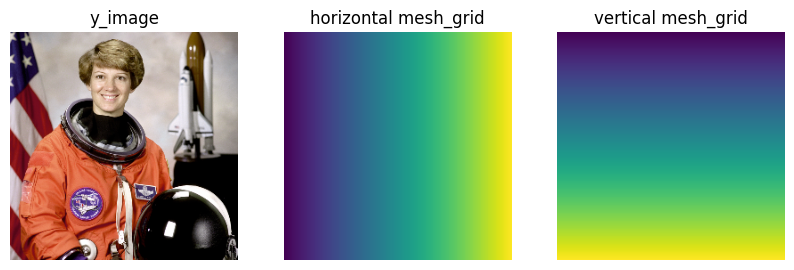

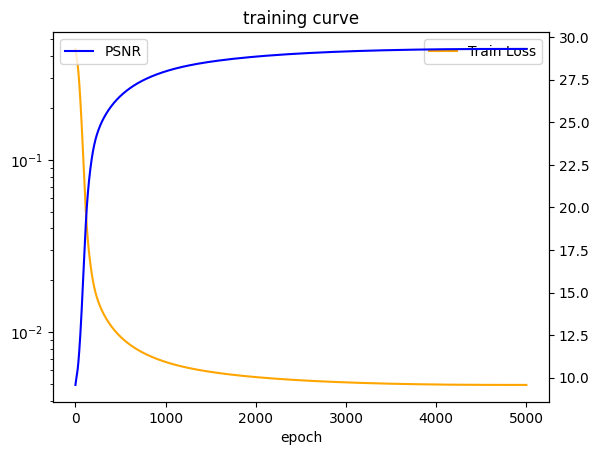

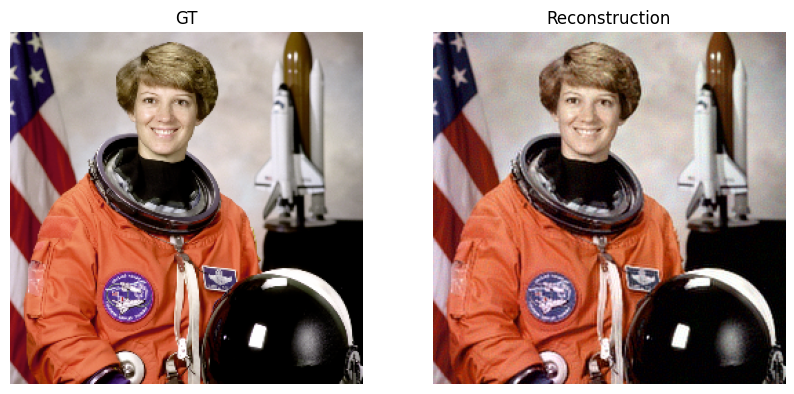

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-3
epochs = 5000

filter = 'Fourier'
d_hidden = 256
scale = 256.

deq_mode = False
reuse = False
ift = False
grad = 1
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, y_pred, grid_size=grid_size)

Finally, after finishing the above ablation studies, let's squeeze out all the performance of this tiny network! Using the Broyden method with a large solver step threshold further improves PSNR by 1 point.

This code block needs over 30 minutes to achieve a PSNR of 33.2-33.8.
Time to grab a coffee before seeing the final result!

Shape of x_train (1, 256, 256, 2)
Shape of y_train (1, 256, 256, 3)
Model Parameters: 68,099
Img Size: 196,608
Compression ratio: 0.346


 20%|██        | 100/500 [05:14<35:36,  5.34s/it]

[Train] Loss: 0.00477, || PSNR: 29.47 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [13:02<29:24,  5.88s/it]

[Train] Loss: 0.00250, || PSNR: 32.28 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [21:19<19:52,  5.96s/it]

[Train] Loss: 0.00194, || PSNR: 33.37 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [29:40<10:00,  6.01s/it]

[Train] Loss: 0.00179, || PSNR: 33.72 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [37:19<00:00,  4.48s/it]

[Train] Loss: 0.00177, || PSNR: 33.77 || Lr: [1e-06]


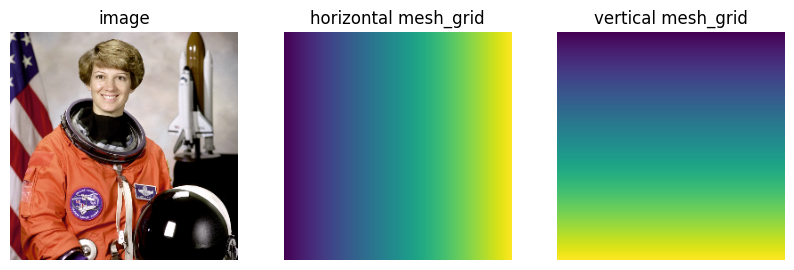

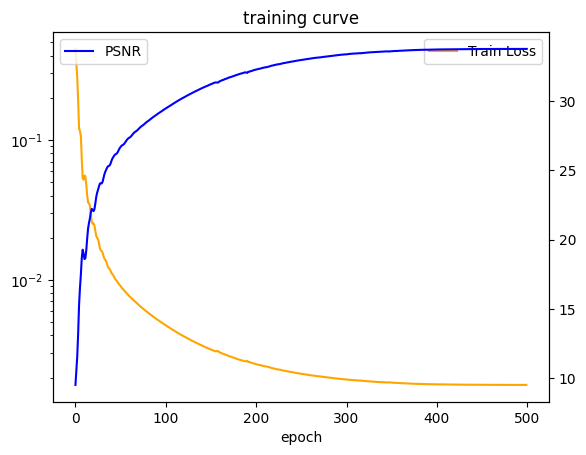

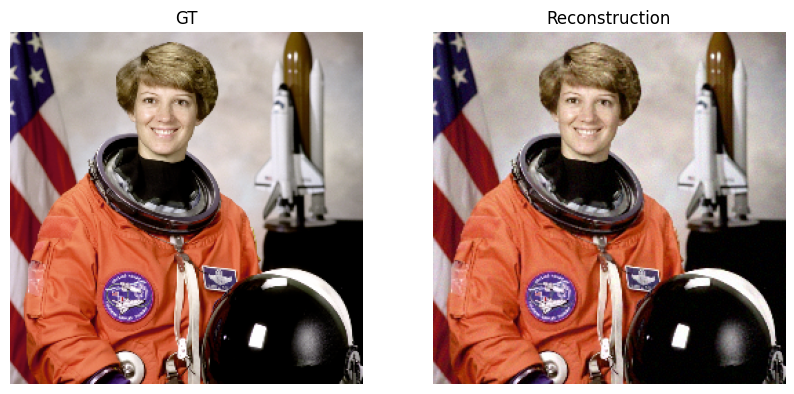

In [ ]:
# Configs
grid_size = 256
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
scale = 128.

deq_mode = True
reuse = False
ift = True
grad = 1
norm_type = 'spectral_norm'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type,
        f_solver='broyden', f_max_iter=40,
        b_solver='broyden', b_max_iter=40).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)
plot_training_stats(loss_log, psnr_log)
visualize_results(y_train, y_pred, grid_size=grid_size)

Congrats! You have walked through a long tutorial on DEQ models and TorchDEQ!

Wanna try more? Here are several examples of high-resolution image reconstruction. We will run more compact INRs/DEQ-INRs for larger image sizes. Enjoy!

In [ ]:
def visualize_triple_results(y_orig, exp_y_pred, imp_y_pred, grid_size=512, file_name=None):
    y_orig = postprocess(y_orig).detach().cpu().numpy()
    exp_y_pred = postprocess(exp_y_pred).detach().cpu().numpy()
    imp_y_pred = postprocess(imp_y_pred).detach().cpu().numpy()
    data_channels = y_orig.shape[-1]

    fig, ax = plt.subplots(1, 3, figsize=(10, 40), dpi=500)
    if data_channels == 1:
        ax[0].imshow(y_orig.reshape(grid_size, grid_size), cmap='gray')
        ax[1].imshow(exp_y_pred.reshape(grid_size, grid_size), cmap='gray')
        ax[2].imshow(imp_y_pred.reshape(grid_size, grid_size), cmap='gray')
    else:
        ax[0].imshow(y_orig.reshape((grid_size, grid_size, data_channels)))
        ax[1].imshow(exp_y_pred.reshape((grid_size, grid_size, data_channels)))
        ax[2].imshow(imp_y_pred.reshape((grid_size, grid_size, data_channels)))

    ax[0].set_title("Ground Truth")
    ax[0].axis('off')
    ax[1].set_title("INR Reconstruction")
    ax[1].axis('off')
    ax[2].set_title("DEQ-INR Reconstruction")
    ax[2].axis('off')

    # If a filename is provided, save the figure to a file.
    if file_name:
        plt.savefig(file_name, bbox_inches='tight', pad_inches=0.1)
    else:
        plt.show()

Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 1)
Model Parameters: 39,985
Img Size: 262,144
Compression ratio: 0.153


 20%|██        | 100/500 [00:22<01:45,  3.81it/s]

[Train] Loss: 0.01033, || PSNR: 25.89 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [00:44<01:18,  3.82it/s]

[Train] Loss: 0.01008, || PSNR: 26.00 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [01:06<00:52,  3.82it/s]

[Train] Loss: 0.01001, || PSNR: 26.03 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [01:28<00:26,  3.74it/s]

[Train] Loss: 0.00998, || PSNR: 26.04 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [01:50<00:00,  4.51it/s]


[Train] Loss: 0.00998, || PSNR: 26.04 || Lr: [1e-06]
Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 1)
Model Parameters: 39,985
Img Size: 262,144
Compression ratio: 0.153


 20%|██        | 100/500 [00:25<04:32,  1.47it/s]

[Train] Loss: 0.00579, || PSNR: 28.35 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [00:49<03:22,  1.48it/s]

[Train] Loss: 0.00489, || PSNR: 29.14 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [01:14<02:14,  1.49it/s]

[Train] Loss: 0.00457, || PSNR: 29.43 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [01:38<01:07,  1.48it/s]

[Train] Loss: 0.00445, || PSNR: 29.55 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [02:03<00:00,  4.06it/s]

[Train] Loss: 0.00441, || PSNR: 29.59 || Lr: [1e-06]


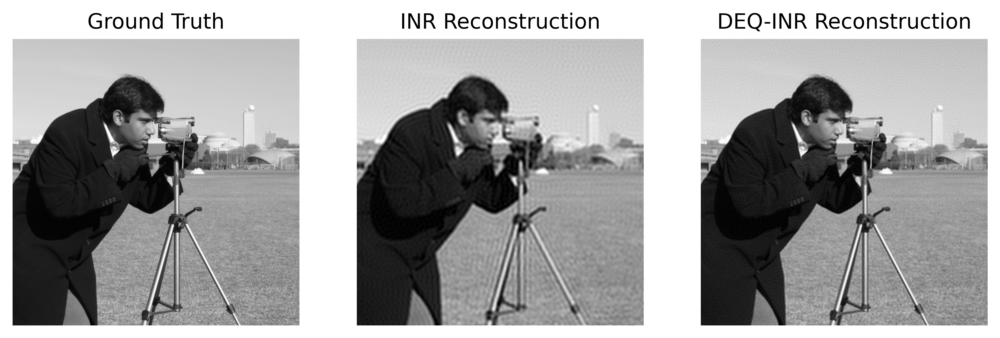

In [ ]:
# Configs for INR
grid_size = 512
img = 'camera'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 196
scale = 128.

deq_mode = False
reuse = False
ift = False
grad = 1
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

exp_y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Configs for DEQ-INR
grid_size = 512
img = 'camera'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 196
scale = 128.

deq_mode = True
reuse = True
ift = False
grad = 5
norm_type = 'spectral_norm'


device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Visualize the reconstruction results
visualize_triple_results(y_train, exp_y_pred, y_pred, grid_size=grid_size, file_name='camera.png')

Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 3)
Model Parameters: 151,299
Img Size: 786,432
Compression ratio: 0.192


 20%|██        | 100/500 [00:42<03:21,  1.99it/s]

[Train] Loss: 0.01127, || PSNR: 25.61 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [01:24<02:35,  1.93it/s]

[Train] Loss: 0.01097, || PSNR: 25.72 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [02:06<01:40,  1.99it/s]

[Train] Loss: 0.01087, || PSNR: 25.75 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [02:49<00:52,  1.91it/s]

[Train] Loss: 0.01084, || PSNR: 25.77 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [03:32<00:00,  2.36it/s]


[Train] Loss: 0.01083, || PSNR: 25.77 || Lr: [1e-06]
Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 3)
Model Parameters: 151,299
Img Size: 786,432
Compression ratio: 0.192


 20%|██        | 100/500 [00:55<09:36,  1.44s/it]

[Train] Loss: 0.00392, || PSNR: 30.23 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [01:50<07:07,  1.42s/it]

[Train] Loss: 0.00327, || PSNR: 30.79 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [02:44<04:44,  1.42s/it]

[Train] Loss: 0.00273, || PSNR: 31.56 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [03:39<02:24,  1.44s/it]

[Train] Loss: 0.00221, || PSNR: 32.60 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [04:33<00:00,  1.83it/s]

[Train] Loss: 0.00206, || PSNR: 32.94 || Lr: [1e-06]


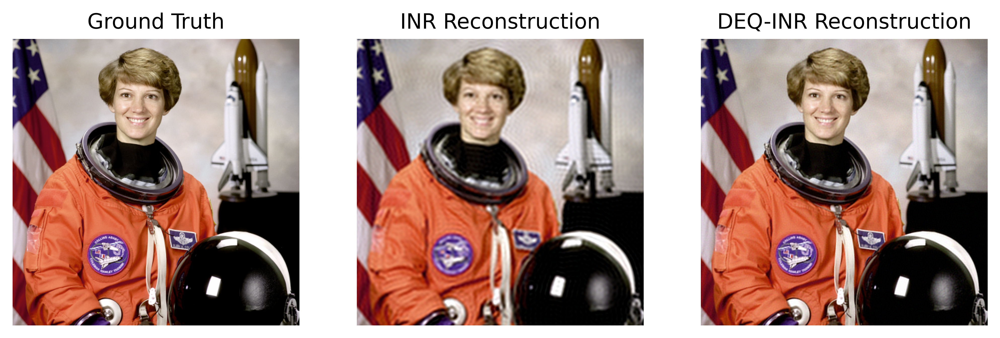

In [ ]:
# Configs for INR
grid_size = 512
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 384
scale = 128.

deq_mode = False
reuse = False
ift = False
grad = 1
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

exp_y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Configs for DEQ-INR
grid_size = 512
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 384
scale = 128.

deq_mode = True
reuse = True
ift = False
grad = 5
norm_type = 'spectral_norm'


device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=1, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Visualize the reconstruction results
visualize_triple_results(y_train, exp_y_pred, y_pred, grid_size=grid_size, file_name='astronaut.png')

Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 3)
Model Parameters: 201,219
Img Size: 786,432
Compression ratio: 0.256


 20%|██        | 100/500 [00:37<02:53,  2.30it/s]

[Train] Loss: 0.00507, || PSNR: 29.20 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [01:14<02:11,  2.28it/s]

[Train] Loss: 0.00334, || PSNR: 31.01 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [01:51<01:26,  2.30it/s]

[Train] Loss: 0.00278, || PSNR: 31.80 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [02:28<00:42,  2.33it/s]

[Train] Loss: 0.00260, || PSNR: 32.08 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [03:05<00:00,  2.69it/s]


[Train] Loss: 0.00258, || PSNR: 32.13 || Lr: [1e-06]
Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 3)
Model Parameters: 201,219
Img Size: 786,432
Compression ratio: 0.256


 20%|██        | 100/500 [01:12<08:33,  1.28s/it]

[Train] Loss: 0.00320, || PSNR: 31.11 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [02:24<08:00,  1.60s/it]

[Train] Loss: 0.00191, || PSNR: 33.32 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [03:37<05:17,  1.59s/it]

[Train] Loss: 0.00150, || PSNR: 34.35 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [04:49<02:38,  1.59s/it]

[Train] Loss: 0.00131, || PSNR: 34.96 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [06:02<00:00,  1.38it/s]

[Train] Loss: 0.00127, || PSNR: 35.12 || Lr: [1e-06]


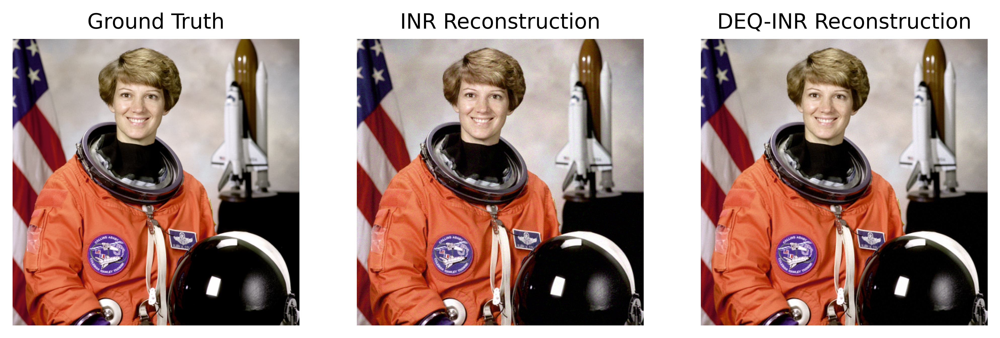

In [ ]:
# Configs for INR
grid_size = 512
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
n_layer = 3
scale = 256.

deq_mode = False
reuse = False
ift = False
grad = 1
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=n_layer, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

exp_y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Configs for DEQ-INR
grid_size = 512
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
n_layer = 3
scale = 128.

deq_mode = True
reuse = True
ift = False
grad = 5
norm_type = 'spectral_norm'


device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=n_layer, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)


# Visualize the reconstruction results
visualize_triple_results(y_train, exp_y_pred, y_pred, grid_size=grid_size, file_name='astronaut.png')

DEQ-INR and INR have different frequency biases. Run this block to use the same `scale` factor as DEQ-INR, but worse than the INR config shown above.

In [ ]:
# Configs for INR
grid_size = 512
img = 'astronaut'

lr = 1e-2
epochs = 500

filter = 'Fourier'
d_hidden = 256
n_layer = 3
scale = 128.

deq_mode = False
reuse = False
ift = False
grad = 1
norm_type = 'none'

device = torch.device('cuda:0')
log_freq = 100

# Training a mini INR for image reconstruction!
Model = get_model(filter)

x_train, y_train = load_data(img, grid_size, device=device, show_img=False)
model = Model(d_in=2, d_out=y_train.shape[-1], d_hidden=d_hidden, n_layer=n_layer, scale=scale,
        deq_mode=deq_mode, ift=ift, grad=grad, norm_type=norm_type).to(device)

exp_y_pred, loss_log, psnr_log = train(model, x_train, y_train, lr=lr, log_freq=log_freq)

Shape of x_train (1, 512, 512, 2)
Shape of y_train (1, 512, 512, 3)
Model Parameters: 201,219
Img Size: 786,432
Compression ratio: 0.256


 20%|██        | 100/500 [00:37<02:53,  2.31it/s]

[Train] Loss: 0.00495, || PSNR: 29.18 || Lr: [0.009045180463377551]


 40%|████      | 200/500 [01:14<02:10,  2.30it/s]

[Train] Loss: 0.00434, || PSNR: 29.74 || Lr: [0.006545430463377552]


 60%|██████    | 300/500 [01:51<01:26,  2.32it/s]

[Train] Loss: 0.00414, || PSNR: 29.95 || Lr: [0.003455569536622448]


 80%|████████  | 400/500 [02:28<00:43,  2.29it/s]

[Train] Loss: 0.00406, || PSNR: 30.03 || Lr: [0.00095581953662245]


100%|██████████| 500/500 [03:06<00:00,  2.69it/s]

[Train] Loss: 0.00405, || PSNR: 30.04 || Lr: [1e-06]
